# Stochastic Gradient Descent (SGD)

```{figure} ./images/sgd-meme.png
:align: center
:width: 400px
```

**Stochastic Gradient Descent** is an optimization algorithm that differs from the usual **Gradient Descent** in that the gradient of the optimized function is considered at each step **not as the sum** of gradients from each element of the sample, but as the gradient from **one randomly** selected element

# Gradient Descent (GD) review
Before going into the study of stochastic gradient descent, let's recall the formula of ordinary gradient descent.
We have the following:
* $\boldsymbol w$ = ${(w_1, w_2, ..., w_n)}^{T}$ is a vector of parameters, where $n$ is the size of the $\boldsymbol w$
* $L$ - differentiable multi-variable function
* $\nabla L(\boldsymbol w)$ - gradient of the function (the meaning is shown {eq}`vector-func-diff`)
* $Q(\boldsymbol w)$ - function which we tend to minimize where with respect to "$\boldsymbol w$" or $Q(\boldsymbol w) =  \sum\limits_{i=1}^\ell  L_i(\boldsymbol w) \to \min\limits_{\boldsymbol w}$
* $\ell$ - number of input vector parameters <br>
Choose $\boldsymbol w^{(0)}$ - initial vector approach. Then, each subsequent vector of parameters will be calculated as 

```{math}
:label: gd-formula
\boldsymbol w = \boldsymbol w - \eta \sum\limits_{i=1}^\ell \nabla L_i(\boldsymbol w)
```

where $\eta$ - gradient step or learning rate (responsible for how much to change the vector of parameters in the direction of the gradient)

The stopping of the algorithm will be determined by the convergence of $Q$ or $\boldsymbol w$.


In [1]:
import numpy as np
import plotly.graph_objects as go

def f(x):
    return x*x - 5*x + 5

def df(x):
    return 2*x - 5

# Number of iterations
N = 20
# Initial value
xx = 0
# Convergence step
lmd = 0.85

x_plt = np.arange(-0.5, 5.5, 0.1)
y_plt = [f(x) for x in x_plt]

fig = go.Figure()

# Plot the function f(x)
# fig.add_trace(go.Scatter(x=x_plt, y=y_plt, mode='lines', name='f(x)', line=dict(color='black')))

# Initialize the point
point = go.Scatter(x=[xx], y=[f(xx)], mode='markers+lines', marker=dict(color='red'), line=dict(color='red'), name='Gradient Path')
fig.add_trace(point)

# Set layout
fig.update_layout(
    title='Gradient Descent Optimization (learning rate = 0.85)',
    xaxis_title='x',
    yaxis_title='f(x)',
    showlegend=True,
    legend=dict(x=0.7, y=0.9, bordercolor="Black", borderwidth=1),
    updatemenus=[dict(type='buttons', showactive=False, buttons=[dict(label='Play',
                                        method='animate',
                                        args=[None, dict(frame=dict(duration=300, redraw=True), fromcurrent=True)])])])

# Create frames for animation
frames = [go.Frame(data=[go.Scatter(x=(xx,), y=(f(xx),), mode='markers+lines', marker=dict(color='red'), line=dict(color='red'))])]

for i in range(N):
    xx = xx - lmd * df(xx)
    # Include all previous points in each frame
    if i != N - 1:
        frames.append(go.Frame(data=[go.Scatter(x=frames[i]['data'][0]['x'] + (xx,),
                                            y=frames[i]['data'][0]['y'] + (f(xx),),
                                            mode='markers+lines', marker=dict(color='red'), line=dict(color='red'))]))
    else:
        frames.append(go.Frame(data=[go.Scatter(x=frames[i]['data'][0]['x'] + (xx,),
                                            y=frames[i]['data'][0]['y'] + (f(xx),),
                                            mode='markers+lines', marker=dict(color='blue'), line=dict(color='red'))]))
        fig.update_layout(
            title=f'GD (learning rate = 0.85) x = {xx:.2f}',
            xaxis_title='x',
            yaxis_title='f(x)',
            showlegend=True,
            legend=dict(x=0.7, y=0.9, bordercolor="Black", borderwidth=1),
            updatemenus=[dict(type='buttons', showactive=False, buttons=[dict(label='Play',
                                                method='animate',
                                                args=[None, dict(frame=dict(duration=300, redraw=True), fromcurrent=True)])])])


fig.frames = frames

# Display the initial quadratic function on the background
fig.add_trace(go.Scatter(x=x_plt, y=y_plt, mode='lines', name='f(x) = x^2-5x+5', line=dict(color='gray', width=2)))

# Display the animation
fig.show()

# Stochastic Gradient Descent (SGD)

## GD algorithm problem

Considering the previous algorithm {eq}`gd-formula`, we come to a **problem**. To determine a new approximation of the vector $\boldsymbol w$, it is necessary to calculate the gradient of each element i.e. $ \sum\limits_{i=1}^\ell \nabla L_i(\boldsymbol w)$ 
**HOWEVER** It can significantly slow down the algorithm since it is very resource - intensive

## SGD derivation
In order to improve the efficiency of the algorithm we may **replace** calculation of the **real gradient** for the whole input points with the **pseudogradient** for only one point or sequence of points.

**Pseudogradient** ($\nabla \widehat Q$) must have the following properties:
* It must form an **acute (sharp) angle** with a **true gradient** in the "$n$" dimensional space
* It must be **calculated much simpler** than the true gradient $\nabla Q(\boldsymbol w)$ over the input points.

```{figure} ./images/pseudogradient.png
:align: center
:width: 400px
```

Accordingly, at each step, instead of calculating the whole sum of gradients from the whole number of inputs ($\sum\limits_{i=1}^{\ell} \nabla L_i(\boldsymbol w)$) one observation can be considered ($\nabla L_k(\boldsymbol w)$), i.e. 
```{math}
:label: sgd-formula
\boldsymbol w = \boldsymbol w - \eta  \nabla L_k(\boldsymbol w)
```

where, $ 1\leqslant k \leqslant \ell$ (usually random)

```{admonition} Did you know that...
:class: tip, dropdown
"SGD" abbreviation is not just a Stochastic gradient descent. It is also known as short for the Singapore Dollar, which looks like this

![Albuquerque, New Mexico](./images/singapore_dollar.jpg)

By the way, the exchange rate of 1 Singapore dollar (SGD) at the time of writing this topic is 344.38 tenge (tg)

```

## SGD Realization Pseudocode

```{prf:algorithm} Stochastic Gradient descent
:label: SGD
:nonumber:

* Input: Convergence step (learning rate) "$\eta$", rate of "forgetting" "$\lambda$"
* Output: Vector of parameters $\boldsymbol w$

To solve the optimization problem

$$
    L(\boldsymbol w) \to \min\limits_{\boldsymbol w}
$$

do the followind steps:
1. Initialization of $\boldsymbol w$ with some initial values (e.g., from $\mathcal N(0, 1$))
2. Initial calculation of the function: $(\widehat Q (\boldsymbol w) = \frac 1\ell \sum\limits_{i=1}^\ell L_i(\boldsymbol w))$
3. While $\widehat Q$ and/or $\boldsymbol w$ don't reach set values DO:
* Choose random index value $k$ where, 1 \leqslant k \leqslant \ell
* Calculate function $E_k = L_k(\boldsymbol w)$
* Recalculate vector: $\boldsymbol w = \boldsymbol w - \eta  \nabla L_k(\boldsymbol w)$ (rate of "forgetting" "$\lambda$" is just a constant which is commonly very small)
* Recalculate function:  $\widehat Q = \lambda E_k + (1-\lambda)\widehat Q$
4. return "$\boldsymbol w$"

```

**Q**: How was the function $\widehat Q = \lambda E_k + (1-\lambda)\widehat Q$ derived?
```{admonition} Hint
:class: tip, dropdown
Use the formula for finding just an average:

$$ \widehat Q_{\ell} =  \frac 1{\ell} (E_{\ell} + E_{\ell - 1} + E_{\ell - 2} + ... + E_1)$$

Then try to express the same formula for $Q_{\ell - 1}$ and think how to combine them. <br>
Assume that, $\lambda = \frac 1{\ell}$
```

In [2]:
import plotly.graph_objects as go
import numpy as np
import tensorflow as tf

def f(x):
    return x**2

# Define the derivative of f(x)
def df(x):
    return 2*x

# SGD optimization process
def sgd_optimization(learning_rate, initial_x, num_iterations):
    # tensorflow
    tfx = tf.Variable(10.0)
    x_values = np.array([initial_x])
    y_values = np.array([f(initial_x)])
    
    optimizer = tf.keras.optimizers.legacy.SGD(learning_rate=learning_rate)
    
    for i in range(num_iterations):
        val = optimizer.minimize(lambda: f(tfx), var_list=[tfx])
        x_values = np.append(x_values, tfx.numpy())
        y_values = np.append(y_values, f(tfx).numpy())
        
    return x_values, y_values
    
    #x_values = np.array([initial_x])
    #for i in range(num_iterations):
    #    gradient = df(x_values[-1])
    #    update = learning_rate * gradient
    #    new_x = x_values[-1] - update
    #    x_values = np.append(x_values, new_x)
    #return x_values

# Create figure
fig = go.Figure()

# Add traces, one for each slider step
for step in np.arange(0, 1.2, 0.05):
    x, y = sgd_optimization(step, 10, 10)
    #y = f(x)
    fig.add_trace(
        go.Scatter(
            visible=False,
            line=dict(color="red", width=3),
            name="SGD optimization",
            x = x,
            #x=np.arange(0, 10, 0.01),
            y=y))
            #y=np.sin(step * np.arange(0, 10, 0.01))))

# Make 8th trace visible
fig.data[10].visible = True

fig.add_trace(
    go.Scatter(
            visible=False,
            line=dict(color="gray", width=2),
            name="x^2",
            x = np.arange(-12.0, 12.0, 0.1),
            #x=np.arange(0, 10, 0.01),
            y=f(np.arange(-12.0, 12.0, 0.1))))
            #y=np.sin(step * np.arange(0, 10, 0.01))))
    
fig.add_trace(
    go.Scatter(
            visible=False,
            line=dict(color="gray", width=2),
            name="x^2",
            x = np.arange(-30.0, 30.0, 0.1),
            y=f(np.arange(-30.0, 30.0, 0.1))))

fig.add_trace(
    go.Scatter(
            visible=False,
            line=dict(color="gray", width=2),
            name="x^2",
            x = np.arange(-70.0, 70.0, 0.1),
            y=f(np.arange(-70.0, 70.0, 0.1))))

fig.add_trace(
    go.Scatter(
            visible=False,
            line=dict(color="gray", width=2),
            name="x^2",
            x = np.arange(-150.0, 150.0, 0.1),
            y=f(np.arange(-150.0, 150.0, 0.1))))
    
fig.data[len(fig.data) - 4].visible = True

# Create and add slider
steps = []
for i in range(1, len(fig.data)-4):
    step = dict(
        method="update",
        args=[{"visible": [False] * len(fig.data)},
              {"title": "Learning rate: " + f"{(i*0.05):.2f}"}],  # layout attribute
    )
    if (i < len(fig.data) - 7):
        step["args"][0]["visible"][len(fig.data) - 4] = True
    elif (i == len(fig.data) - 7):
        step["args"][0]["visible"][len(fig.data) - 3] = True
    elif (i == len(fig.data) - 6):
        step["args"][0]["visible"][len(fig.data) - 2] = True
    elif (i == len(fig.data) - 5):
        step["args"][0]["visible"][len(fig.data) - 1] = True
    step["args"][0]["visible"][i] = True  # Toggle i'th trace to "visible"
    step['label']=f"{(i*0.05):.2f}"
    
    steps.append(step)

sliders = [dict(
    active=9,
    currentvalue={"prefix": "Learning rate: "},
    pad={"t": 50},
    steps=steps
)]

button = dict(
        label="Play",
        method="animate",
        args=[None],
        #args=[{"visible": [False] * len(fig.data)},
        #      {"title": "Learning rate: " + f"{(i*0.05):.2f}"}],  # layout attribute
    )

fig.update_layout(
    title="Learning rate: 0.50",
    sliders=sliders
    #,
    #updatemenus=[dict(type='buttons',
    #showactive=False,
    #buttons=[button])]
)

fig.show()

### SGD Exercise:
**Given**: <br>
$\boldsymbol w = (w_1, w_2, w_3) ^ T = (1, -1, 0.5) ^ T$ <br> 
$\eta = 0.1$ <br>
$\lambda = 0.8$ <br>
$L(\boldsymbol w) = w_1^{2} + w_2^{2} + 0.5 w_3^{2}$ <br>
What are the parameters of $\boldsymbol w$ in the next iteration?

In [3]:
from jupyterquiz import display_quiz
q_w1 = [{
    "question": "What is the value of $w_1$?",
    "type": "numeric",
    "answers": [
        {
            "type": "value",
            "value": 0.8,
            "correct": True,
            "feedback": "Correct!"
        },
        {
            "type": "default",
            "feedback": "Incorrect answer! Examine the SGD algorithm again"
        }
         ]
        },
        {
    "question": "What is the value of $w_2$?",
    "type": "numeric",
    "answers": [
        {
            "type": "value",
            "value": - 0.8,
            "correct": True,
            "feedback": "Correct!"
        },
        {
            "type": "default",
            "feedback": "Incorrect answer! Examine the SGD algorithm again"
        }
    ]
        },
        {
    "question": "What is the value of $w_3$?",
    "type": "numeric",
    "answers": [
        {
            "type": "value",
            "value": 0.475,
            "correct": True,
            "feedback": "Correct!"
        },
        {
            "type": "default",
            "feedback": "Incorrect answer! Examine the SGD algorithm again"
        }
    ]
    
    }
]

display_quiz(q_w1)

<IPython.core.display.Javascript object>

## Mini Batch GD
**Mini batch gradient descent** is actually a mixture of Batch Gradient Descent and SGD. It computes the gradient of the function over small random subsets of the elemets (mini batches).

```{prf:algorithm} Mini Batch GD
:label: MiNIGD
:nonumber:

To solve the optimization problem:

$$
    L(\boldsymbol w) \to \min\limits_{\boldsymbol w}
$$

do the followind steps:
1. Initialization of $\boldsymbol w$ with some initial values (e.g., from $\mathcal N(0, 1$))
2. Initial calculation of the function: $(\widehat Q (\boldsymbol w) = \frac 1\ell \sum\limits_{i=1}^\ell L_i(\boldsymbol w))$
3. While $\widehat Q$ and/or $\boldsymbol w$ don't reach set values DO:
* Choose subset of $m$ random indexes $k$ i.e $B$ = {$k_1, k_2, ..., k_m$}, where 1 $\leqslant m$ < $\ell$
* Calculate function $E_{B}(\boldsymbol w) = \sum\limits_{i \in B} L_i(\boldsymbol w)$
* Recalculate vector: $\boldsymbol w = \boldsymbol w - \eta  \sum\limits_{i \in B} \nabla L_i(\boldsymbol w)$
* Recalculate function:  $\widehat Q = \lambda E_{B}(\boldsymbol w) + (1-\lambda)\widehat Q$
4. return $\boldsymbol w$
```

### Mini Batch GD VS SGD

In [4]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import matplotlib.pyplot as plt
import torch
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
torch.manual_seed(42)

# Creating a function f(X) with a slope of -5
X = torch.arange(-5, 5, 0.1).view(-1, 1)
func = -5 * X
# Adding Gaussian noise to the function f(X) and saving it in Y
Y = func + 0.4 * torch.randn(X.size())

w = torch.tensor(-10.0, requires_grad=True)
b = torch.tensor(-20.0, requires_grad=True)

# defining the function for forward pass for prediction
def forward(x):
    return w * x + b

# evaluating data points with Mean Square Error (MSE)
def criterion(y_pred, y):
    return torch.mean((y_pred - y) ** 2)

# Creating our dataset class
class Build_Data(Dataset):
    # Constructor
    def __init__(self):
        self.x = torch.arange(-5, 5, 0.1).view(-1, 1)
        self.y = -5 * X
        self.len = self.x.shape[0]
    # Getting the data
    def __getitem__(self, index):
        return self.x[index], self.y[index]
    # Getting length of the data
    def __len__(self):
        return self.len

# Creating DataLoader object
dataset = Build_Data()
train_loader = DataLoader(dataset=dataset, batch_size=1)

step_size = 0.1
loss_SGD = []
n_iter = 20

for i in range(n_iter):
    # calculating loss as in the beginning of an epoch and storing it
    y_pred = forward(X)
    loss_SGD.append(criterion(y_pred, Y).tolist())
    for x, y in train_loader:
        # making a prediction in forward pass
        y_hat = forward(x)
        # calculating the loss between original and predicted data points
        loss = criterion(y_hat, y)
        # backward pass for computing the gradients of the loss w.r.t to learnable parameters
        loss.backward()
        # updating the parameters after each iteration
        w.data = w.data - step_size * w.grad.data
        b.data = b.data - step_size * b.grad.data
        # zeroing gradients after each iteration
        w.grad.data.zero_()
        b.grad.data.zero_()

train_loader_10 = DataLoader(dataset=dataset, batch_size=10)

# Reset w and b
w = torch.tensor(-10.0, requires_grad=True)
b = torch.tensor(-20.0, requires_grad=True)

loss_MBGD_10 = []

for i in range(n_iter):
    # calculating loss as in the beginning of an epoch and storing it
    y_pred = forward(X)
    loss_MBGD_10.append(criterion(y_pred, Y).tolist())
    for x, y in train_loader_10:
        # making a prediction in forward pass
        y_hat = forward(x)
        # calculating the loss between original and predicted data points
        loss = criterion(y_hat, y)
        # backward pass for computing the gradients of the loss w.r.t to learnable parameters
        loss.backward()
        # updating the parameters after each iteration
        w.data = w.data - step_size * w.grad.data
        b.data = b.data - step_size * b.grad.data
        # zeroing gradients after each iteration
        w.grad.data.zero_()
        b.grad.data.zero_()

train_loader_20 = DataLoader(dataset=dataset, batch_size=20)

# Reset w and b
w = torch.tensor(-10.0, requires_grad=True)
b = torch.tensor(-20.0, requires_grad=True)

loss_MBGD_20 = []

for i in range(n_iter):
    # calculating loss as in the beginning of an epoch and storing it
    y_pred = forward(X)
    loss_MBGD_20.append(criterion(y_pred, Y).tolist())
    for x, y in train_loader_20:
        # making a prediction in forward pass
        y_hat = forward(x)
        # calculating the loss between original and predicted data points
        loss = criterion(y_hat, y)
        # backward pass for computing the gradients of the loss w.r.t to learnable parameters
        loss.backward()
        # updating the parameters after each iteration
        w.data = w.data - step_size * w.grad.data
        b.data = b.data - step_size * b.grad.data
        # zeroing gradients after each iteration
        w.grad.data.zero_()
        b.grad.data.zero_()


fig = make_subplots(rows=1, cols=1)

# Add traces for each line
fig.add_trace(go.Scatter(x=[], y=[], mode='lines', name='SGD', line=dict(width=2)))
fig.add_trace(go.Scatter(x=[], y=[], mode='lines', name='Mini Batch 10 GD', line=dict(width=2)))
fig.add_trace(go.Scatter(x=[], y=[], mode='lines', name='Mini Batch 20 GD', line=dict(width=2)))

# Update layout
fig.update_layout(
    xaxis_title='Epoch',
    yaxis_title='L(w) value',
    title_text='Mini Batch GD VS SGD',
    showlegend=True,
    updatemenus=[{
        'type': 'buttons',
        'showactive': False,
        'buttons': [{
            'label': 'Play',
            'method': 'animate',
            'args': [None, {
                'frame': {'duration': 500, 'redraw': True},
                'fromcurrent': True
            }]
        }]
    }]
)
fig.update_xaxes(range=[1, n_iter + 1])  
fig.update_yaxes(range=[-200, max(max(loss_SGD), max(loss_MBGD_10), max(loss_MBGD_20)) + 200])
# Define the animation frames
frames = [go.Frame(
    data=[go.Scatter(x=list(range(1, i+2)), y=loss_SGD[:i+1], mode='lines', name='SGD', line=dict(width=2)),
          go.Scatter(x=list(range(1, i+2)), y=loss_MBGD_10[:i+1], mode='lines', name='Mini Batch 10 GD', line=dict(width=2)),
          go.Scatter(x=list(range(1, i+2)), y=loss_MBGD_20[:i+1], mode='lines', name='Mini Batch 20 GD', line=dict(width=2))]
) for i in range(n_iter)]

fig.frames = frames

# Show the figure
fig.show()

In [5]:
from jupyterquiz import display_quiz
import json
from base64 import b64encode

def get_spanned_encoded_q(q, q_name):
    byte_code = b64encode(bytes(json.dumps(q), 'utf8'))
    return f'<span style="display:none" id="{q_name}">{byte_code.decode()}</span>'

q_e_1_eng = [{
    "question": "What is the main difference between SGD and GD?",
    "type": "many_choice",
    "answers": [
        {
            "answer": "SGD algorithm is slower than GD",
            "correct": False,
            "feedback": "Incorrect! SGD is faster since it uses random"
        },
        {
            "answer": "SGD uses a random subset of data, while GD uses all the data",
            "correct": True,
            "feedback": "Correct!"
        },
        {
            "answer": "SGD always uses the same batch size",
            "correct": False,
            "feedback": "Incorrect! he batch size in SGD can vary during training"
        },
        {
            "answer": "SGD is the currency while GD is the Surname and name shortness",
            "correct": False,
            "feedback": "Yes, but no..."
        },
    ]
}]

display_quiz(q_e_1_eng)

<IPython.core.display.Javascript object>

## Heuristics

According to the [description](https://en.wikipedia.org/wiki/Heuristic),  "**heuristics**" is understood as a set of techniques as well as the methods that facilitate and simplify the solution of corresponded tasks. Here is the list of suggested heuristics during the work with the SGD:
* Initialization of the vector $\boldsymbol w$
* Choice for learning rate $\eta$

### Initialization of the vector $\boldsymbol w$
One of the crucial steps during SGD algorithm is initialization of the $\boldsymbol w$. It is common to set **zero vector** as initial values, but there are also other approaches.
1. So, w = 0;

Another way is to take **small random** $w$, since if initialize large initial values it can lead to an area with small modulo derivatives and therefore it will be difficult to get out of such an area.

2. So, $w_j$ = random($-\frac 1{2n}$, $\frac 1{2n}$) (The denominator is devided by "$2n$" because if case of $n$ = 1 the learning rate would be 1, but that's an unppropriate value. So, it can be at least 0.5 in this case.)


### Dynamic Learning Rate $\eta$
As an optimization, **learning rate variable $\eta$** value can be **dynamicly changed** at each step of iteration. Replace **$\eta$** with a time-dependent learning rate **$\eta(t)$**. There is a list of some commonly used formulas for $\eta(t)$.

$$\eta(t)=\frac 1{t}$$
$$ \eta(t)=\eta_i \;\;\text{ if }\;\; t_i \leqslant t < t_{i+1} $$
$$\eta(t)=\eta_o \cdot e^{-\lambda t}, \;\;\text{exponential decay}\;\;$$
$$\eta(t)=\eta_o \cdot (\beta t + 1)^{-\alpha}, \;\;\text{polynomial decay}\;\;$$

```{note}

If $\eta(t)$ changes **too quick**, then **stop optimizing** prematurely. If we decrease it **too slowly**, we **waste** too much **time** on optimization. 

```
#### Constant learning rate VS Dynamic learning rate
Firstly, look at the SGD with $\eta$ = 0.1

In [6]:
import numpy as np
import plotly.graph_objs as go
from plotly.subplots import make_subplots

# Objective function and its gradient
def objective_function(x):
    return x**2

def gradient(x):
    return 2*x

def stochastic_gradient_descent(initial_x, learning_rate, epochs):
    x_values = [initial_x]
    for epoch in range(epochs):
        gradient_val = gradient(x_values[-1])
        update = -learning_rate * gradient_val
        new_x = x_values[-1] + update
        x_values.append(new_x)
    return x_values

def create_animation(x_values, objective_function):
    x_vals = np.linspace(-10, 10, 1000)
    y_vals = objective_function(x_vals)

    fig = make_subplots(rows=1, cols=1, subplot_titles=["SGD with constant learning rate 0.1",])
    scatter = go.Scatter(x=x_vals, y=y_vals, mode='lines', name='Quadratic function')
    points = go.Scatter(x=[x_values[0]], y=[objective_function(x_values[0])], mode='markers', name='SGD Steps')
  
    fig.add_trace(scatter)
    fig.add_trace(points)

    frames = [go.Frame(data=[
        go.Scatter(x=x_vals, y=y_vals, mode='lines', name='Objective Function'),
        go.Scatter(x=x_values[:i+1], y=[objective_function(x) for x in x_values[:i+1]],
                   mode='markers+lines', name='SGD Steps')       
    ]) for i in range(1, len(x_values))]

    fig.frames = frames
    return fig

initial_x = 5
learning_rate = 0.1
epochs = 30

x_values = stochastic_gradient_descent(initial_x, learning_rate, epochs)
animation_fig = create_animation(x_values, objective_function)

animation_fig.update_layout(updatemenus=[dict(type='buttons', showactive=False, buttons=[dict(label='Play',
                                 method='animate', args=[None, dict(frame=dict(duration=500, redraw=True),
                                 fromcurrent=True)])])])

animation_fig.show()


Next, compare the previous graph to the SGD with exponential learning rate or $\eta(t)=\eta_o \cdot e^{-\lambda t}\;$ ($\lambda$ = 0.1)

In [7]:
import numpy as np
import plotly.graph_objs as go
from plotly.subplots import make_subplots

# Objective function and its gradient
def objective_function(x):
    return x**2

def stable_objective_function(x):
    epsilon = np.finfo(float).eps
    return x**2 + epsilon

def gradient(x):
    return 2*x

def stochastic_gradient_descent(initial_x, iterations, decay_rate):
    x_values = [initial_x]
    for t in range(1, iterations + 1):
        learning_rate = np.exp(-decay_rate * t)
        grad = gradient(x_values[-1])
        x_values.append(x_values[-1] - learning_rate * grad + np.random.normal(0, 1))
    return x_values

def create_animation(x_values, objective_function):
    x_vals = np.linspace(-10, 10, 1000)
    y_vals = objective_function(x_vals)

    fig = make_subplots(rows=1, cols=1, subplot_titles=["SGD with exponential learning Rate",])
    scatter = go.Scatter(x=x_vals, y=y_vals, mode='lines', name='Quadratic function')
    points = go.Scatter(x=[x_values[0]], y=[objective_function(x_values[0])], mode='markers', name='SGD Steps')
  
    fig.add_trace(scatter)
    fig.add_trace(points)

    frames = [go.Frame(data=[
        go.Scatter(x=x_vals, y=y_vals, mode='lines', name='Objective Function'),
        go.Scatter(x=x_values[:i+1], y=[objective_function(x) for x in x_values[:i+1]],
                   mode='markers+lines', name='SGD Steps')       
    ]) for i in range(1, len(x_values))]

    fig.frames = frames
    return fig

initial_x = 5  
iterations = 15
decay_rate = 0.1

x_values = stochastic_gradient_descent(initial_x, iterations, decay_rate)
animation_fig = create_animation(x_values, stable_objective_function)

animation_fig.update_layout(updatemenus=[dict(type='buttons', showactive=False, buttons=[dict(label='Play',
                                 method='animate', args=[None, dict(frame=dict(duration=500, redraw=True),
                                 fromcurrent=True)])])])

animation_fig.show()


## Advantages and Disadvantages
As any algorithm, the SGD has its own pros and cons. <br>
**Advatages**:
* Simple for implementation
* if the function $L$ is not differentiable, it can be approximated by differentiable
* Suitable for the exercises with huge number of data (input points)

**Disadvantages**:
* It can simply get stuck in local optima
* It has strong fluctuation

In [8]:
from jupyterquiz import display_quiz

q_e_2_eng = [{
    "question": "Choose the correct statements:",
    "type": "many_choice",
    "answers": [
        {
            "answer": "SGD always converges to global optimum",
            "correct": False
        },
        {
            "answer": "Learning rate's value does't matter for SGD",
            "correct": False
        },
        {
            "answer": "Angle between pseudogradient and real gradient must be sharp",
            "correct": True
        },
        {
            "answer": "Learning rate influences how fast the GD moves",
            "correct": True
        },
    ]   
}]

display_quiz(q_e_2_eng)

<IPython.core.display.Javascript object>

## Optimizers of Gradient Algorithms

The main disadvantage of gradient algorithms is getting stuck in local optima (minimum).

```{figure} https://upload.wikimedia.org/wikipedia/commons/thumb/6/68/Extrema_example_original.svg/1200px-Extrema_example_original.svg.png
:align: center
```

Moreover, at **such points, the derivative is zero**, which means that the further change of vector parameters $\boldsymbol w$ according to the formula {eq}`sgd-formula` ( $\nabla Q(w) = \nabla L_k(w, x_k)$ = 0 ) will not happen (we will stuck). <br>

Consider the graph below to see the stuck in local optima.

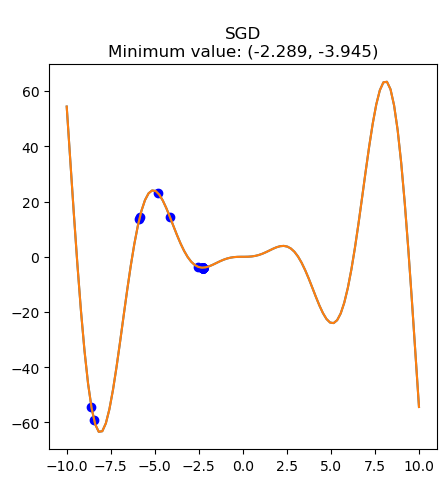

In [9]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

# Define the function and its derivative
def f(x):
    return x ** 2 * tf.math.sin(x)
optimizers = [
    tf.keras.optimizers.SGD(learning_rate=0.1),
]
 
optimizer_names = ["SGD"]


# Set up the plot
fig, axs = plt.subplots(1, 1, figsize=(5, 5))
x_vals = np.linspace(-10, 10, 100)
y_vals = f(x_vals)

# Initialize variables for each optimizer
tfx_list = [tf.Variable(-5.27) for _ in range(len(optimizers))]
opt_list = optimizers
visited_points = [[] for _ in range(len(optimizers))]

# Animation function
def update(frame, lines, scatters, titles):
    for i, opt in enumerate(opt_list):
        val = opt.minimize(lambda: f(tfx_list[i]), var_list=[tfx_list[i]])
        visited_points[i].append((tfx_list[i].numpy(), f(tfx_list[i]).numpy()))
        lines[i].set_data(x_vals, f(x_vals))
        scatters[i].set_offsets(visited_points[i])
        titles[i].set_text(f"\n{optimizer_names[i]}\nMinimum value: ({np.round(tfx_list[i].numpy(), 3):.3f}, {np.round(f(tfx_list[i]).numpy(), 3):.3f})")

# Set up the plots for each optimizer
lines_list = [axs.plot([], [])[0] ]
scatters_list = [axs.scatter([], [], color='blue')]
titles_list = [axs.set_title("")]


axs.plot(x_vals, y_vals)

# Set up the animation
ani = FuncAnimation(fig, update, frames=100, fargs=(lines_list, scatters_list, titles_list), interval=100, repeat=False)

# Display the animation
from IPython.display import HTML
HTML(ani.to_jshtml())


Moreover, at **such points, the derivative is zero**, which means that the further change of vector parameters $\boldsymbol w$ according to the formula {eq}`sgd-formula` ( $\nabla Q(w) = \nabla L_k(w, x_k)$ = 0 ) will not happen (we will stuck). <br>


In addition, stochastic gradient algorithms can form **strong fluctuations** when moving to the minimum point of the function

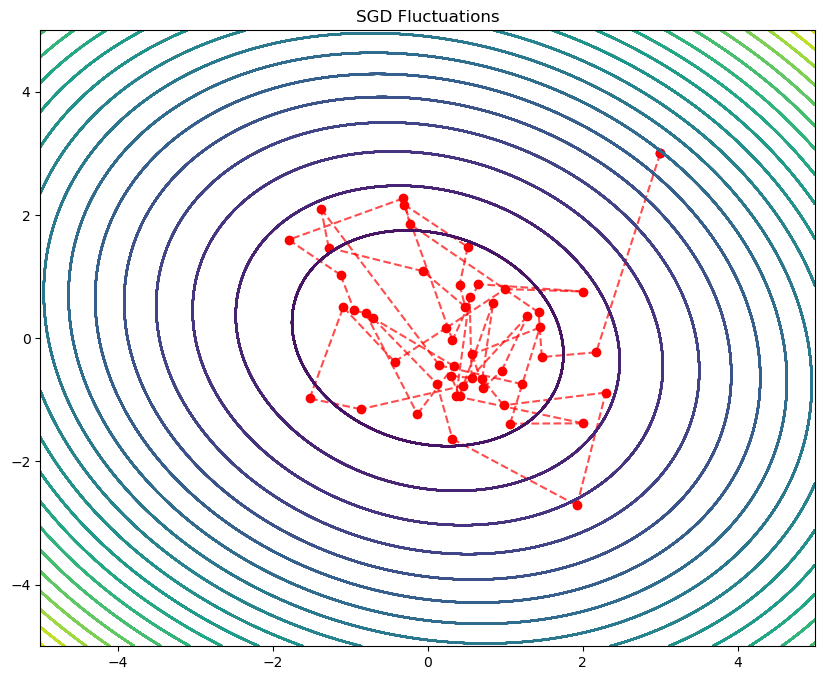

In [10]:
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import display, clear_output
import time

# Define the objective function (multidimensional)
def objective_function(x, y):
    return x**2 + y**2 + 0.3 * x * y

# Gradient of the objective function
def gradient(x, y):
    return np.array([2*x + 0.3*y, 2*y + 0.3*x])

# Stochastic Gradient Descent algorithm with noise and convergence threshold
def stochastic_gradient_descent(initial_point, learning_rate, num_iterations, noise_scale=0.05, convergence_threshold=0.01):
    points = [initial_point]
    for _ in range(num_iterations):
        grad = gradient(*points[-1])
        noise = noise_scale * np.random.randn(2)  # Adding Gaussian noise
        update = -learning_rate * (grad + noise)
        new_point = points[-1] + update
        points.append(new_point)
        
        # Check convergence
        if np.linalg.norm(update) < convergence_threshold:
            break
    
    return np.array(points)

# Initial parameters
initial_point = np.array([3, 3])
learning_rate = 0.2
num_iterations = 50

# Create a contour plot of the objective function
x = np.linspace(-5, 5, 100)
y = np.linspace(-5, 5, 100)
X, Y = np.meshgrid(x, y)
Z = objective_function(X, Y)

fig, ax = plt.subplots(figsize=(10, 8))
contour = ax.contour(X, Y, Z, levels=20, cmap='viridis')
ax.set_title('SGD Fluctuations')


# Plot the initial point
initial_point_plot = ax.scatter(*initial_point, color='blue', label='Initial Point')

# Plot the trajectory of SGD with noise and convergence threshold step-by-step
trajectory = stochastic_gradient_descent(initial_point, learning_rate, num_iterations, noise_scale=4.2, convergence_threshold=0.1)

for i in range(len(trajectory)):
    # Clear the previous plot
    clear_output(wait=True)
    
    # Plot the contour
    contour = ax.contour(X, Y, Z, levels=20, cmap='viridis')
    
    # Plot the dashed lines connecting points
    if i > 0:
        ax.plot([trajectory[i-1, 0], trajectory[i, 0]], [trajectory[i-1, 1], trajectory[i, 1]], linestyle='dashed', color='red', alpha=0.7)
    
    # Plot the current point
    ax.scatter(*trajectory[i], color='red', label=f'SGD Step {i+1}')
    
    # Update the display
    display(fig)
    
    # Pause for 50ms
    time.sleep(0.05)

# Plot the final point
ax.scatter(*trajectory[-1], color='green', label='Final Point')

# Close the figure after the loop
plt.close()



For solving above problems there were dedicated several **solutions**. See below

### Momentum Gradient Descent

```{figure} ./images/momentum-meme.png
:align: center
:width: 400px
```

It was proposed to average the gradient in steps using the formula:

```{math}
:label: momentum-formula
\boldsymbol v = \gamma \boldsymbol v + (1-\gamma)\eta_t \cdot \nabla Q(\boldsymbol w)
```

where, $\boldsymbol v$ - accumulates the average of the gradients <br>
$\;\;\;\;\;\;\;\;\;\gamma$ - parameter (using it, you can adjust how many past gradients we will take into account in the value of $\boldsymbol v$)

```{note}
if rewrite the $(1-\gamma)\eta_t$ from the formula {eq}'momentum-formula' to $\eta_t = (1-\gamma)\cdot\eta_t$ we obtain the algorithm:
$\boldsymbol v = \gamma \boldsymbol v + \eta_t \cdot \nabla Q(\boldsymbol w)$
```

Finally, just change the $\boldsymbol w$ using the familiar principle:
```{math}
:label: weight-momentum-formula
\boldsymbol w = \boldsymbol w - \boldsymbol v
```

where, $\boldsymbol v$ - smoothed gradients

```{admonition} How does the $\gamma$ influences the number of last gradients averaged?
:class: note, dropdown
The expression shows how the number of last gradients are considered in for $\boldsymbol v$ calcucation
$N \approx \frac 2 {(1-\gamma)} + 1$ 

It is an approximate formula because the in exponential moving average all the gradients are averaged that were met.
```


### NAG - Nesterov's accelerated gradient
Taking into account the already mentioned formula in momentum:

$$\boldsymbol v = \gamma \boldsymbol v + \eta_t \cdot \nabla Q(\boldsymbol w)$$

where, $\eta_t = (1-\gamma)\cdot\eta_t$ for simplicity

Now, we can represent the "$\boldsymbol v$" as the sum of the vectors "$\gamma \boldsymbol v$" and "$\eta_t \cdot \nabla Q(\boldsymbol w)$".
```{figure} ./images/sgd-momentum.png
:align: center
:width: 500px
```
But at the time of calculating the gradient, we already know that we will shift by the value of "$\gamma \boldsymbol v$". Therefore, it would be more correct to calculate the gradient not at point $\boldsymbol w$, but at point ($\boldsymbol w - \gamma \boldsymbol v$) or:

```{figure} ./images/sgd-nesterov.png
:align: center
:width: 500px
```
The detailed step by step NAG visualization algorithm to quadratic function ($f(x) = x^2$) is shown below. The moving ahead step is also added.

```{figure} ./images/nesterov-detailed.png
:align: center
```

Mathematically NAG can be expressed as:

```{math}
:label: sgd-nesterov-formula
\boldsymbol v = \gamma \boldsymbol v + \eta_t \cdot \nabla Q(\boldsymbol w-\gamma \boldsymbol v)
```

And such an approach, as a rule, shows the best convergence to the optimum point.



In [11]:
from jupyterquiz import display_quiz
import json
from base64 import b64encode

def get_spanned_encoded_q(q, q_name):
    byte_code = b64encode(bytes(json.dumps(q), 'utf8'))
    return f'<span style="display:none" id="{q_name}">{byte_code.decode()}</span>'

q_gamma = [{
    "question": "What value should $(\\gamma)$ take to obtain the GD formula? $$ v = \gamma v + (1-\gamma)\eta_t \cdot \\nabla Q(w) $$",
    "type": "numeric",
    "answers": [
        {
            "type": "value",
            "value": 0,
            "correct": True,
            "feedback": "Correct!"
        },
        {
            "type": "default",
            "feedback": "Incorrect answer! Think one more time"
        }
    ]
}
]

display_quiz(q_gamma)

<IPython.core.display.Javascript object>

### SGD VS with Momentum VS with Nesterov Momentum
#### Visualization for $f(x) = x^2sin x$

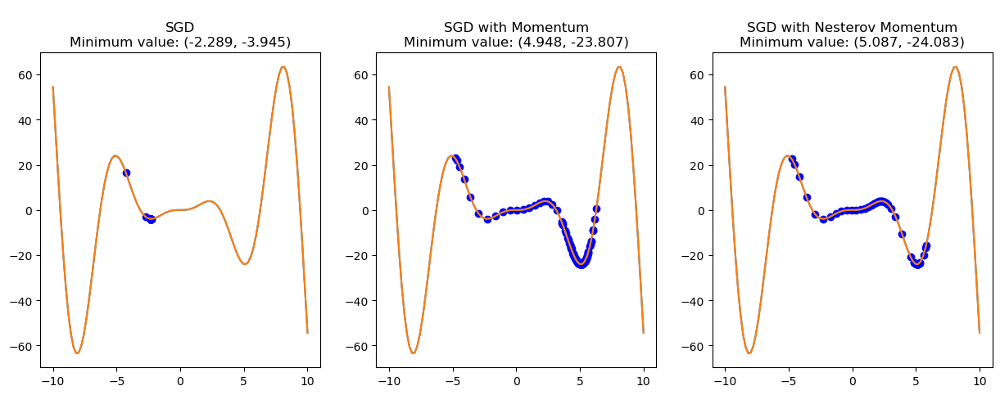

In [12]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

# Define the function and its derivative
def f(x):
    return x ** 2 * tf.math.sin(x)
optimizers = [
    tf.keras.optimizers.legacy.SGD(learning_rate=0.1),
    tf.keras.optimizers.legacy.SGD(learning_rate=0.01, momentum=0.96),
    tf.keras.optimizers.legacy.SGD(learning_rate=0.01, momentum=0.96, nesterov=True),
]
 
optimizer_names = ["SGD", "SGD with Momentum", "SGD with Nesterov Momentum"]


# Set up the plot
fig, axs = plt.subplots(1, 3, figsize=(15, 5))
x_vals = np.linspace(-10, 10, 100)
y_vals = f(x_vals)

# Initialize variables for each optimizer
tfx_list = [tf.Variable(-4.87) for _ in range(len(optimizers))]
opt_list = optimizers
visited_points = [[] for _ in range(len(optimizers))]

# Animation function
def update(frame, lines, scatters, titles):
    for i, opt in enumerate(opt_list):
        val = opt.minimize(lambda: f(tfx_list[i]), var_list=[tfx_list[i]])
        visited_points[i].append((tfx_list[i].numpy(), f(tfx_list[i]).numpy()))
        lines[i].set_data(x_vals, f(x_vals))
        scatters[i].set_offsets(visited_points[i])
        titles[i].set_text(f"\n{optimizer_names[i]}\nMinimum value: ({np.round(tfx_list[i].numpy(), 3):.3f}, {np.round(f(tfx_list[i]).numpy(), 3):.3f})")

# Set up the plots for each optimizer
lines_list = [ax.plot([], [])[0] for ax in axs]
scatters_list = [ax.scatter([], [], color='blue') for ax in axs]
titles_list = [ax.set_title("") for ax in axs]

for ax in axs:
    ax.plot(x_vals, y_vals)

# Set up the animation
ani = FuncAnimation(fig, update, frames=100, fargs=(lines_list, scatters_list, titles_list), interval=100, repeat=False)

# Display the animation
from IPython.display import HTML
HTML(ani.to_jshtml())

#### Visualization for $f(x) = x^2$

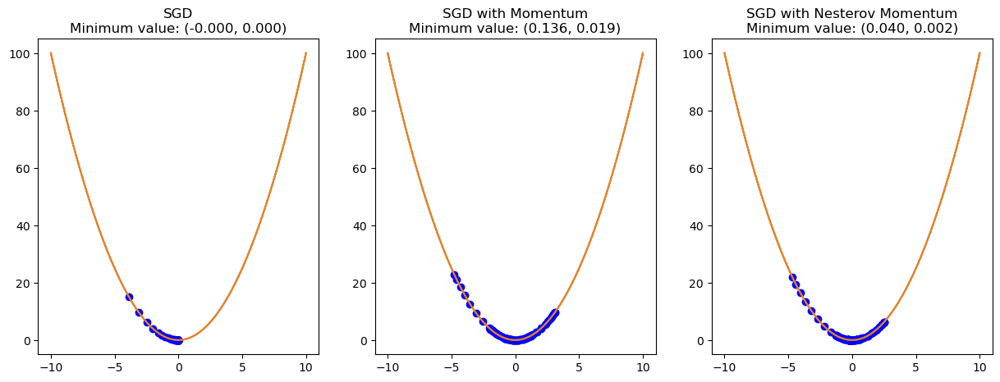

In [13]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

# Define the function and its derivative
def f(x):
    return x ** 2
optimizers = [
    tf.keras.optimizers.legacy.SGD(learning_rate=0.1),
    tf.keras.optimizers.legacy.SGD(learning_rate=0.01, momentum=0.96),
    tf.keras.optimizers.legacy.SGD(learning_rate=0.01, momentum=0.96, nesterov=True),
]
 
optimizer_names = ["SGD", "SGD with Momentum", "SGD with Nesterov Momentum"]
# Set up the plot
fig, axs = plt.subplots(1, 3, figsize=(15, 5))
x_vals = np.linspace(-10, 10, 100)
y_vals = f(x_vals)

# Initialize variables for each optimizer
tfx_list = [tf.Variable(-4.87) for _ in range(len(optimizers))]
opt_list = optimizers
visited_points = [[] for _ in range(len(optimizers))]

# Animation function
def update(frame, lines, scatters, titles):
    for i, opt in enumerate(opt_list):
        val = opt.minimize(lambda: f(tfx_list[i]), var_list=[tfx_list[i]])
        visited_points[i].append((tfx_list[i].numpy(), f(tfx_list[i]).numpy()))
        lines[i].set_data(x_vals, f(x_vals))
        scatters[i].set_offsets(visited_points[i])
        titles[i].set_text(f"{optimizer_names[i]}\nMinimum value: ({np.round(tfx_list[i].numpy(), 3):.3f}, {np.round(f(tfx_list[i]).numpy(), 3):.3f})")

# Set up the plots for each optimizer
lines_list = [ax.plot([], [])[0] for ax in axs]
scatters_list = [ax.scatter([], [], color='blue') for ax in axs]
titles_list = [ax.set_title("SGD") for ax in axs]

for ax in axs:
    ax.plot(x_vals, y_vals)

# Set up the animation
ani = FuncAnimation(fig, update, frames=100, fargs=(lines_list, scatters_list, titles_list), interval=100, repeat=False)

# Display the animation
from IPython.display import HTML
HTML(ani.to_jshtml())